In [1]:
import pandas as pd
import numpy as np
import math as m
import random as rand
import matplotlib.pyplot as plt
import seaborn as sns
import re
from datetime import datetime
from sklearn import linear_model as lm, metrics, ensemble as ens
from sklearn.model_selection import train_test_split, cross_val_score, RepeatedKFold
from sklearn.preprocessing import StandardScaler, normalize
from sklearn.svm import SVC
from sklearn.feature_selection import RFE, RFECV, SequentialFeatureSelector
import random

In [2]:
#PLOT RF FI FUNCTION I FOUND ONLINE
def plot_feature_importance(importance, names, model_type, name, threshold):
    
    #Create arrays from freature importance and feature names
    feature_importance = np.array(importance)
    feature_names = np.array(names)
    
    #CREATE A DATAFRAME USING A DICTIONARY
    data = {'feature_names': feature_names, 'feature_importance': feature_importance}
    fi_df = pd.DataFrame(data)
    
    #SORT THE DF IN ORDER DECREASING FI
    fi_df.sort_values(by = ['feature_importance'], ascending = False, inplace = True)
    
    #filter
    fi_df = fi_df[fi_df['feature_importance'] >= threshold]
    
    #DEFINE SIZE OF BAR PLOT
    plt.figure(figsize = (5, 6))
    
    #PLOT SEABORN BAR CHART
    sns.barplot(x = fi_df['feature_importance'], y = fi_df['feature_names'])
    
    #ADD CHART LABELS
    plt.title(model_type + ' Feature Importance')
    plt.xlabel('Feature Importance')
    plt.ylabel('Feature Names')
    plt.savefig(name, bbox_inches='tight')

# Updated Data Set Up (From Geroge)

### Clinical Data

In [104]:
#DEFINING A FUNCTION TO UPDATE COLUMN NAMES LATER
def lower_no_space(word): 
    
    word = re.sub(' ', '_', word) 
    
    word = re.sub(r'\'', '', word) 
    
    word = re.sub(r'\(', '', word)
    
    word = re.sub(r'\)', '', word)
    
    word = re.sub('\?', '', word)
    
    word = re.sub('/', '_', word)
    
    word = word.lower()
    
    return word

In [105]:
#READ IN ORIGINAL CLINICAL DATA FOR LATER USE (CONVERTED TO .csv IN GOOGLE SHEETS)
df_clin = pd.read_csv("Homebase.csv", header = 1)

In [106]:
#RENAMING COLUMNS
df_clin = df_clin.rename(mapper = lower_no_space, axis = 1) 
df_clin.rename(columns={'subject_sample_id':'sample_id'}, inplace=True)

In [107]:
#CHECK CLINICAL DATA BASICS
df_clin.head()

,patient_id,data_access_group,sample_id,country_of_origin,country_of_residence,gender,race,ethnicity,date_of_initial_diagnosis,age_at_initial_diagnosis,...,date_of_relapse_disease_progression,date_of_relapse_disease_progression.1,date_of_relapse_disease_progression.2,date_of_relapse_disease_progression.3,disease_status_at_time_of_sampling,disease_status_at_time_of_data_entry,date_of_death,age_at_death,death_related_to_disease,complete
0,795-1,MD Anderson,spz-20,NaN,United States of America,Female,White,Not Hispanic or Latino or Spanish Origin,2005-05-05,72.0,...,2008-11-16,2010-11-26,2012-04-22,NaN,Progressive disease,Deceased,2013-03-10,80.0,Yes,Complete
1,795-2,MD Anderson,spz-3,NaN,United States of America,Female,White,Not Hispanic or Latino or Spanish Origin,2011-10-14,81.0,...,2012-06-22,2012-10-31,2013-03-06,2013-06-05,Progressive disease,Deceased,2015-08-19,85.0,Yes,Complete
2,795-3,MD Anderson,spz-4,NaN,United States of America,Male,White,Not Hispanic or Latino or Spanish Origin,2012-04-24,85.0,...,2013-05-14,2014-05-01,NaN,NaN,Stable disease,Deceased,2014-05-12,87.0,Yes,Complete
3,795-4,MD Anderson,spz-8,NaN,United States of America,Male,White,Not Hispanic or Latino or Spanish Origin,2010-07-09,65.0,...,2010-12-15,2012-02-24,NaN,NaN,Progressive disease,Deceased,2017-05-14,72.0,No,Complete
4,795-5,MD Anderson,spz-10,NaN,United States of America,Male,White,Not Hispanic or Latino or Spanish Origin,2012-06-25,87.0,...,2013-08-26,2014-02-24,NaN,NaN,Progressive disease,Deceased,2017-06-17,92.0,No,Complete


In [108]:
#TONS OF DATA, PULL WHAT WE WANT
df_clin_lean = df_clin.drop(columns = [x for x in df_clin.columns if x not in ['gender', 'race', \
                                       'country_of_residence', 'sample_id', 'ethnicity',\
                                        'age_at_initial_diagnosis', 't', 'n', 'm', 'b',\
                                        'predominant_lesion_type_at_diagnosis','lymph_node_biopsy_performed',\
                                        'family_history_of_leukemia_lymphoma', \
                                        'has_the_patient_ever_been_exposed_at_work_or_in_the_service_to_a_toxic_chemical',\
                                        'cd4+:cd8+_ratio', 'total_lymphocyte_count', 'absolute_cd4+_count_per_ul',\
                                        '%cd4+cd26-', '%cd4+cd7-', 'tcr_clonality', 'tumor_cell_cd30+',\
                                        'large_cell_transformation', 'ldh_u_l', 'wbc_103_μl', 'rbc_106_μl',\
                                        'hematocrit_%', 'mcv_fl', 'mchc_g_dl', 'rdw_%', 'platelet_count_103_μl',\
                                        'segmented_neutrophil,_absolute_103_μl', 'lymphocyte,_absolute_103_μl',\
                                        'monocytes,_absolute_103_μl', 'eosinophils,_absolute_103_μl',\
                                        'basophils,_absolute_103_μl', 'segmented_neutrophils_%', 'lymphocytes_%',\
                                        'monocytes_%', 'eosinophils_%', 'basophils_%']])

In [109]:
# TURN YES/NO & POSITIVE/NEGATIVE TO DUMMIES
df_clin_lean['lymph_node_biopsy_performed'] = \
df_clin_lean['lymph_node_biopsy_performed'].apply(lambda x: 1 if x == 'Yes' else 0)

df_clin_lean['family_history_of_leukemia_lymphoma'] = \
df_clin_lean['family_history_of_leukemia_lymphoma'].apply(lambda x: 1 if x == 'Yes' else 0)

df_clin_lean['tumor_cell_cd30+'] = \
df_clin_lean['tumor_cell_cd30+'].apply(lambda x: 1 if x == 'Yes' else 0)

df_clin_lean['large_cell_transformation'] = \
df_clin_lean['large_cell_transformation'].apply(lambda x: 1 if x == 'Yes' else 0)

df_clin_lean['tcr_clonality'] = \
df_clin_lean['tcr_clonality'].apply(lambda x: 1 if x == 'Positive' else 0)

df_clin_lean['has_the_patient_ever_been_exposed_at_work_or_in_the_service_to_a_toxic_chemical'] = \
df_clin_lean['has_the_patient_ever_been_exposed_at_work_or_in_the_service_to_a_toxic_chemical'].apply(lambda x: 1 if x == 'Yes' else 0)

# Clinical Data updated_ Alex

In [264]:
#READ IN Updated CLINICAL DATA FOR LATER USE (CONVERTED TO .csv IN GOOGLE SHEETS)
df_clin_updated = pd.read_csv("Homebase_updated.csv", header = 1)

In [265]:
#RENAMING COLUMNS
df_clin_updated = df_clin_updated.rename(mapper = lower_no_space, axis = 1) 
df_clin_updated.rename(columns={'subject_sample_id':'sample_id'}, inplace=True)

In [266]:
#CHECK CLINICAL DATA BASICS
df_clin_updated.head()

,patient_id,data_access_group,sample_id,date_of_birth,current_age_at_time_of_data_entry_-_can_answer_instead_of_dob,country_of_origin,country_of_residence,gender,race,ethnicity,...,age_at_date_of_relapse_disease_progression_4_can_answer_instead_of_date_of_relapse_disease_progression_4,date_of_relapse_disease_progression.4,age_at_date_of_relapse_disease_progression_5_can_answer_instead_of_date_of_relapse_disease_progression_5,disease_status_at_time_of_sampling,disease_status_at_time_of_data_entry,date_of_death,age_at_death_can_answer_instead_of_date_of_death,death_related_to_disease,cause_of_death,complete
0,795-1,MD Anderson,spz-20,1933-03-08,NaN,NaN,United States of America,Female,White,Not Hispanic or Latino or Spanish Origin,...,NaN,NaN,NaN,Progressive disease,Deceased,2013-11-06,NaN,Yes,NaN,Complete
1,795-2,MD Anderson,spz-3,1930-09-04,NaN,NaN,United States of America,Female,White,Not Hispanic or Latino or Spanish Origin,...,NaN,"12-16-2013, 05-19-2014, 09-16-2014, 09-09-2015",NaN,Progressive disease,Deceased,2015-10-26,NaN,Yes,NaN,Complete
2,795-3,MD Anderson,spz-4,1926-12-27,NaN,NaN,United States of America,Male,White,Not Hispanic or Latino or Spanish Origin,...,NaN,NaN,NaN,Stable disease,Deceased,2014-09-14,NaN,Yes,NaN,Complete
3,795-4,MD Anderson,spz-8,1945-08-17,NaN,NaN,United States of America,Male,White,Not Hispanic or Latino or Spanish Origin,...,NaN,NaN,NaN,Progressive disease,Deceased,2018-01-05,NaN,No,NaN,Complete
4,795-5,MD Anderson,spz-10,1925-04-28,NaN,NaN,United States of America,Male,White,Not Hispanic or Latino or Spanish Origin,...,NaN,NaN,NaN,Progressive disease,Deceased,2017-09-25,NaN,No,NaN,Complete


In [267]:
#Compute the age at initial diagnosis from date of birth and date_of_initial_diagnosis
df_clin_updated['date_of_birth'] = pd.to_datetime(df_clin_updated['date_of_birth'])
df_clin_updated['date_of_initial_diagnosis'] = pd.to_datetime(df_clin_updated['date_of_initial_diagnosis'])
df_clin_updated["age_at_initial_diagnosis"] = (pd.DatetimeIndex(df_clin_updated['date_of_initial_diagnosis']).year 
                        - pd.DatetimeIndex(df_clin_updated['date_of_birth']).year)

In [268]:
#Change the data type: date_of_birth, n, m 
df_clin_updated = df_clin_updated.astype({'t':'object', 'b':'object'})


In [269]:
#TONS OF DATA, PULL WHAT WE WANT
df_clin_updated_lean = df_clin_updated.drop(columns = [x for x in df_clin_updated.columns if x not in ['gender', 'race', \
                                       'country_of_residence', 'sample_id', 'ethnicity',\
                                        'age_at_initial_diagnosis', 't', 'n', 'm', 'b',\
                                        'predominant_lesion_type_at_diagnosis','lymph_node_biopsy_performed',\
                                        'family_history_of_leukemia_lymphoma', \
                                        'has_the_patient_ever_been_exposed_at_work_or_in_the_service_to_a_toxic_chemical',\
                                        'cd4+:cd8+_ratio', 'total_lymphocyte_count', 'absolute_cd4+_count_per_ul',\
                                        '%cd4+cd26-', '%cd4+cd7-', 'tcr_clonality', 'tumor_cell_cd30+',\
                                        'large_cell_transformation', 'ldh_u_l', 'wbc_103_μl', 'rbc_106_μl',\
                                        'hematocrit_%', 'mcv_fl', 'mchc_g_dl', 'rdw_%', 'platelet_count_103_μl',\
                                        'segmented_neutrophil,_absolute_103_μl', 'lymphocyte,_absolute_103_μl',\
                                        'monocytes,_absolute_103_μl', 'eosinophils,_absolute_103_μl',\
                                        'basophils,_absolute_103_μl', 'segmented_neutrophils_%', 'lymphocytes_%',\
                                        'monocytes_%', 'eosinophils_%', 'basophils_%']])

In [270]:
# TURN YES/NO & POSITIVE/NEGATIVE TO DUMMIES
df_clin_updated_lean['lymph_node_biopsy_performed'] = \
df_clin_updated_lean['lymph_node_biopsy_performed'].apply(lambda x: 1 if x == 'Yes' else 0)

df_clin_updated_lean['family_history_of_leukemia_lymphoma'] = \
df_clin_updated_lean['family_history_of_leukemia_lymphoma'].apply(lambda x: 1 if x == 'Yes' else 0)

df_clin_updated_lean['tumor_cell_cd30+'] = \
df_clin_updated_lean['tumor_cell_cd30+'].apply(lambda x: 1 if x == 'Yes' else 0)

df_clin_updated_lean['large_cell_transformation'] = \
df_clin_updated_lean['large_cell_transformation'].apply(lambda x: 1 if x == 'Yes' else 0)

df_clin_updated_lean['tcr_clonality'] = \
df_clin_updated_lean['tcr_clonality'].apply(lambda x: 1 if x == 'Positive' else 0)

df_clin_updated_lean['has_the_patient_ever_been_exposed_at_work_or_in_the_service_to_a_toxic_chemical'] = \
df_clin_updated_lean['has_the_patient_ever_been_exposed_at_work_or_in_the_service_to_a_toxic_chemical'].apply(lambda x: 1 if x == 'Yes' else 0)

### df_lean: Preprocessed Genetic Data

In [262]:
# Read in the Preprocessed Genetic Data
df_lean = pd.read_csv ('stats_by_sample.csv')

In [169]:
#CHECK CLINICAL DATA BASICS
df_clin_updated.head()

,patient_id,data_access_group,sample_id,date_of_birth,current_age_at_time_of_data_entry_-_can_answer_instead_of_dob,country_of_origin,country_of_residence,gender,race,ethnicity,...,date_of_relapse_disease_progression.4,age_at_date_of_relapse_disease_progression_5_can_answer_instead_of_date_of_relapse_disease_progression_5,disease_status_at_time_of_sampling,disease_status_at_time_of_data_entry,date_of_death,age_at_death_can_answer_instead_of_date_of_death,death_related_to_disease,cause_of_death,complete,age_at_initial_diagnosis
0,795-1,MD Anderson,spz-20,1933-03-08,NaN,NaN,United States of America,Female,White,Not Hispanic or Latino or Spanish Origin,...,NaN,NaN,Progressive disease,Deceased,2013-11-06,NaN,Yes,NaN,Complete,73.0
1,795-2,MD Anderson,spz-3,1930-09-04,NaN,NaN,United States of America,Female,White,Not Hispanic or Latino or Spanish Origin,...,"12-16-2013, 05-19-2014, 09-16-2014, 09-09-2015",NaN,Progressive disease,Deceased,2015-10-26,NaN,Yes,NaN,Complete,81.0
2,795-3,MD Anderson,spz-4,1926-12-27,NaN,NaN,United States of America,Male,White,Not Hispanic or Latino or Spanish Origin,...,NaN,NaN,Stable disease,Deceased,2014-09-14,NaN,Yes,NaN,Complete,86.0
3,795-4,MD Anderson,spz-8,1945-08-17,NaN,NaN,United States of America,Male,White,Not Hispanic or Latino or Spanish Origin,...,NaN,NaN,Progressive disease,Deceased,2018-01-05,NaN,No,NaN,Complete,66.0
4,795-5,MD Anderson,spz-10,1925-04-28,NaN,NaN,United States of America,Male,White,Not Hispanic or Latino or Spanish Origin,...,NaN,NaN,Progressive disease,Deceased,2017-09-25,NaN,No,NaN,Complete,87.0


In [263]:
#TRANSFORM SAMPLE ID TO JOIN TO CLINICAL DATA
df_lean['sample_id'] = df_lean['sample_id'].apply(lambda x: re.sub('_', '-', x[:5]) if 'WES' in x else\
                                                  (x[:-10] if 'CTCL' in x else \
                                                   ('-'.join([ele.lstrip('0').lower() for ele in x[:-10].split('-')]) if 'SPZ' in x else x)))

# Merge (Original)

In [273]:
#MERGE CLINICAL, GENETIC DATA
df_all = pd.merge(df_lean, df_clin_lean, on='sample_id', how='left')

In [274]:
#IMPUTATION; "UNKNOWN" FOR CATEGORICAL, MEAN FILL-IN FOR CONTINUOUS
for col in df_clin_lean.columns:
    if col in ['race', 'gender', 'country_of_residence', 'ethnicity', 'predominant_lesion_type_at_diagnosis']:
        df_all[col] = df_all[col].fillna('unknown')
    elif col != 'sample_id':
        df_all[col] = df_all[col].fillna(np.mean(df_all[col]))

In [275]:
#GET DUMMIES FOR CATEGORICALS
df_all = pd.get_dummies(df_all, columns = ['race', 'gender', 'country_of_residence', 'ethnicity', 'predominant_lesion_type_at_diagnosis'])


# Merge (Updated)

In [276]:
#MERGE tbe updated CLINICAL, GENETIC DATA
df_all_updated = pd.merge(df_lean, df_clin_updated_lean, on='sample_id', how='left')

In [277]:
#IMPUTATION; "UNKNOWN" FOR CATEGORICAL, MEAN FILL-IN FOR CONTINUOUS
for col in df_clin_updated_lean.columns:
    if col in ['race', 'gender', 'country_of_residence', 'ethnicity', 'predominant_lesion_type_at_diagnosis', 't', 
              'n', 'm', 'b']:
        df_all_updated[col] = df_all_updated[col].fillna('unknown')
    elif col != 'sample_id':
        df_all_updated[col] = df_all_updated[col].fillna(np.mean(df_all_updated[col]))

In [278]:
#GET DUMMIES FOR CATEGORICALS
df_all_updated = pd.get_dummies(df_all_updated, columns = ['race', 'gender', 'country_of_residence', 'ethnicity', 'predominant_lesion_type_at_diagnosis', 
                                                          't', 'n', 'm', 'b'])


# Defining Features and Labels

In [126]:
#DEFINE STANDARDSCALER FOR LATER USE
std_scl = StandardScaler()

In [190]:
# Define (Scaled/Normalized) Features and Labels
X = df_all.drop(columns = [x for x in df_all.columns if x == 'outcome' or x == 'sample_id'])
X_scaled = std_scl.fit_transform(X)
X_norm = normalize(X)

y = df_all.drop(columns = [x for x in df_all.columns if x != 'outcome'])

In [191]:
df_all['outcome'].value_counts(normalize = True)

1    0.798561
0    0.201439
Name: outcome, dtype: float64

## For updated data

In [279]:
#DEFINE STANDARDSCALER FOR LATER USE
std_scl = StandardScaler()

In [280]:
# Define (Scaled/Normalized) Features and Labels
X_new = df_all_updated.drop(columns = [x for x in df_all_updated.columns if x == 'outcome' or x == 'sample_id'])
X_new_scaled = std_scl.fit_transform(X_new)
X_new_norm = normalize(X_new)

y_new = df_all_updated.drop(columns = [x for x in df_all_updated.columns if x != 'outcome'])

In [281]:
df_all_updated['outcome'].value_counts(normalize = True)

1    0.798561
0    0.201439
Name: outcome, dtype: float64

# Model Training - (Original Data)

###  Repeated Stratified K-fold / Repeated K-fold

In [18]:
# 10X ITERATED 3-FOLD CROSS-VALIDATED ACCURACY AND PRECISION FOR MOST ROBUST EVAL W/SMALL SAMPLE
rkf = RepeatedKFold(n_splits=3, n_repeats=10)

In [19]:
# Stratified Version
from sklearn.model_selection import RepeatedStratifiedKFold
rskf = RepeatedStratifiedKFold(n_splits=3, n_repeats=10)

### Logistic Regression

In [20]:
log = lm.LogisticRegression()
acc_scores = cross_val_score(log, X_scaled, y.values.ravel(), scoring='accuracy', cv=rkf, n_jobs=-1)
prec_scores = cross_val_score(log, X_scaled, y.values.ravel(), scoring='precision', cv=rkf, n_jobs=-1)
print('accuracy: ', np.mean(acc_scores))
print('precision: ', np.mean(prec_scores))

accuracy:  0.7985353068146778
precision:  0.7987203206907184


In [21]:
log = lm.LogisticRegression()
acc_scores = cross_val_score(log, X_scaled, y.values.ravel(), scoring='accuracy', cv=rskf, n_jobs=-1)
prec_scores = cross_val_score(log, X_scaled, y.values.ravel(), scoring='precision', cv=rskf, n_jobs=-1)
print('accuracy: ', np.mean(acc_scores))
print('precision: ', np.mean(prec_scores))

accuracy:  0.7986432315757015
precision:  0.7986432315757015


### Random Forest

In [22]:
# RANDOM FOREST (rkf)
rf = ens.RandomForestClassifier()
acc_scores = cross_val_score(rf, X, y.values.ravel(), scoring='accuracy', cv=rkf, n_jobs=-1)
prec_scores = cross_val_score(rf, X, y.values.ravel(), scoring='precision', cv=rkf, n_jobs=-1)
print('accuracy: ', np.mean(acc_scores))
print('precision: ', np.mean(prec_scores))

accuracy:  0.8036077705827938
precision:  0.8043831157707199


In [23]:
# RANDOM FOREST (rskf)
rf = ens.RandomForestClassifier()
acc_scores = cross_val_score(rf, X, y.values.ravel(), scoring='accuracy', cv=rskf, n_jobs=-1)
prec_scores = cross_val_score(rf, X, y.values.ravel(), scoring='precision', cv=rskf, n_jobs=-1)
print('accuracy: ', np.mean(acc_scores))
print('precision: ', np.mean(prec_scores))

accuracy:  0.8036848596978106
precision:  0.8049864354304688


### Ridge Classifier

In [62]:
#RIDGE
rdg = lm.RidgeClassifier()
acc_scores = cross_val_score(rdg, X_norm, y.values.ravel(), scoring='accuracy', cv=rskf, n_jobs=-1)
prec_scores = cross_val_score(rdg, X_norm, y.values.ravel(), scoring='precision', cv=rskf, n_jobs=-1)
print('ridge accuracy: ', np.mean(acc_scores))
print('ridge precision: ', np.mean(prec_scores))

ridge accuracy:  0.8345205057045945
ridge precision:  0.8287028188565311


### Support Vector Classifier (SVC)

In [27]:
#Support Vector Machine
for kern in ['linear', 'poly', 'rbf', 'sigmoid']:
    
    svc = SVC(kernel = kern, probability = True)
    
    acc_scores = cross_val_score(svc, X_norm, y.values.ravel(), scoring='accuracy', cv=rskf, n_jobs=-1)
    prec_scores = cross_val_score(svc, X_norm, y.values.ravel(), scoring='precision', cv=rskf, n_jobs=-1)
    print(kern, ' accuracy: ', np.mean(acc_scores))
    print(kern, ' precision: ', np.mean(prec_scores))

linear  accuracy:  0.8382207832254085
linear  precision:  0.8275922597530497
poly  accuracy:  0.8302189330866482
poly  precision:  0.8253356790009975
rbf  accuracy:  0.8324082639531297
rbf  precision:  0.8250625796288726
sigmoid  accuracy:  0.8302651865556583
sigmoid  precision:  0.8230888596105987


### XGBoost

In [28]:
from numpy import loadtxt
from xgboost import XGBClassifier

model = XGBClassifier()
acc_scores = cross_val_score(model, X, y.values.ravel(), scoring='accuracy', cv=rskf, n_jobs=-1)
prec_scores = cross_val_score(model, X, y.values.ravel(), scoring='precision', cv=rskf, n_jobs=-1)
print('accuracy: ', np.mean(acc_scores))
print('precision: ', np.mean(prec_scores))

/Users/hshen/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/Users/hshen/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/Users/hshen/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/Users/hshen/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. U

accuracy:  0.823882207832254
precision:  0.8507592379106247


### CATBoost

In [29]:
from catboost import CatBoostClassifier

model = CatBoostClassifier(iterations = 100, verbose=10,random_state=123)
acc_scores = cross_val_score(model, X, y.values.ravel(), scoring='accuracy', cv=rskf, n_jobs=-1)
prec_scores = cross_val_score(model, X, y.values.ravel(), scoring='precision', cv=rskf, n_jobs=-1)
print('accuracy: ', np.mean(acc_scores))
print('precision: ', np.mean(prec_scores))

accuracy:  0.8008017267961764
precision:  0.7992136910268269


### AdaBoost

In [30]:
from sklearn.ensemble import AdaBoostClassifier

model = AdaBoostClassifier(random_state=123)
acc_scores = cross_val_score(model, X, y.values.ravel(), scoring='accuracy', cv=rskf, n_jobs=-1)
prec_scores = cross_val_score(model, X, y.values.ravel(), scoring='precision', cv=rskf, n_jobs=-1)
print('accuracy: ', np.mean(acc_scores))
print('precision: ', np.mean(prec_scores))

accuracy:  0.8222479185938946
precision:  0.8659669496526703


# Model Training - (Updated Data)

###  Repeated Stratified K-fold 

In [282]:
# Stratified Version
from sklearn.model_selection import RepeatedStratifiedKFold
rskf = RepeatedStratifiedKFold(n_splits=3, n_repeats=10)

### Logistic Regression

In [283]:
log = lm.LogisticRegression()
acc_scores = cross_val_score(log, X_new_scaled, y_new.values.ravel(), scoring='accuracy', cv=rskf, n_jobs=-1)
prec_scores = cross_val_score(log, X_new_scaled, y_new.values.ravel(), scoring='precision', cv=rskf, n_jobs=-1)
print('accuracy: ', np.mean(acc_scores))
print('precision: ', np.mean(prec_scores))

accuracy:  0.7986432315757015
precision:  0.7986432315757015


### Random Forest

In [284]:
# RANDOM FOREST (rskf)
rf = ens.RandomForestClassifier()
acc_scores = cross_val_score(rf, X_new, y_new.values.ravel(), scoring='accuracy', cv=rskf, n_jobs=-1)
prec_scores = cross_val_score(rf, X_new, y_new.values.ravel(), scoring='precision', cv=rskf, n_jobs=-1)
print('accuracy: ', np.mean(acc_scores))
print('precision: ', np.mean(prec_scores))

accuracy:  0.8051341350601295
precision:  0.8075060970481878


### Ridge Classifier

In [285]:
#RIDGE
rdg = lm.RidgeClassifier()
acc_scores = cross_val_score(rdg, X_new_norm, y_new.values.ravel(), scoring='accuracy', cv=rskf, n_jobs=-1)
prec_scores = cross_val_score(rdg, X_new_norm, y_new.values.ravel(), scoring='precision', cv=rskf, n_jobs=-1)
print('ridge accuracy: ', np.mean(acc_scores))
print('ridge precision: ', np.mean(prec_scores))

ridge accuracy:  0.7965155720012334
ridge precision:  0.7980381676773907


### Support Vector Classifier (SVC)

In [205]:
#Support Vector Machine
for kern in ['linear', 'poly', 'rbf', 'sigmoid']:
    
    svc = SVC(kernel = kern, probability = True)
    
    acc_scores = cross_val_score(svc, X_new_norm, y_new.values.ravel(), scoring='accuracy', cv=rskf, n_jobs=-1)
    prec_scores = cross_val_score(svc, X_new_norm, y_new.values.ravel(), scoring='precision', cv=rskf, n_jobs=-1)
    print(kern, ' accuracy: ', np.mean(acc_scores))
    print(kern, ' precision: ', np.mean(prec_scores))

linear  accuracy:  0.7986432315757015
linear  precision:  0.7986432315757015
poly  accuracy:  0.797918593894542
poly  precision:  0.7984983040394695
rbf  accuracy:  0.7986432315757015
rbf  precision:  0.7986432315757015
sigmoid  accuracy:  0.7986432315757015
sigmoid  precision:  0.7986432315757015


### XGBoost

In [286]:
from numpy import loadtxt
from xgboost import XGBClassifier

model = XGBClassifier()
acc_scores = cross_val_score(model, X_new, y_new.values.ravel(), scoring='accuracy', cv=rskf, n_jobs=-1)
prec_scores = cross_val_score(model, X_new, y_new.values.ravel(), scoring='precision', cv=rskf, n_jobs=-1)
print('accuracy: ', np.mean(acc_scores))
print('precision: ', np.mean(prec_scores))
print(model.best_score)

/Users/hshen/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/Users/hshen/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/Users/hshen/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/Users/hshen/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. U

accuracy:  0.8324236817761331
precision:  0.8637254608922222


NotFittedError: need to call fit or load_model beforehand

[05:35:04] WARNING: /var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_44tbtwf8c1/croots/recipe/xgboost-split_1659548960882/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[05:35:21] WARNING: /var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_44tbtwf8c1/croots/recipe/xgboost-split_1659548960882/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[05:35:34] WARNING: /var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_44tbtwf8c1/croots/recipe/xgboost-split_1659548960882/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to '

### CATBoost

In [209]:
from catboost import CatBoostClassifier

model = CatBoostClassifier(iterations = 100, verbose = 2, random_state=123)
acc_scores = cross_val_score(model, X_new, y_new.values.ravel(), scoring='accuracy', cv=rskf, n_jobs=-1)
prec_scores = cross_val_score(model, X_new, y_new.values.ravel(), scoring='precision', cv=rskf, n_jobs=-1)
print('accuracy: ', np.mean(acc_scores))
print('precision: ', np.mean(prec_scores))

/Users/hshen/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/Users/hshen/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/Users/hshen/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/Users/hshen/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. U

accuracy:  0.8000770891150171
precision:  0.8016240262632494


### AdaBoost

In [210]:
from sklearn.ensemble import AdaBoostClassifier

model = AdaBoostClassifier(random_state=123)
acc_scores = cross_val_score(model, X_new, y_new.values.ravel(), scoring='accuracy', cv=rskf, n_jobs=-1)
prec_scores = cross_val_score(model, X_new, y_new.values.ravel(), scoring='precision', cv=rskf, n_jobs=-1)
print('accuracy: ', np.mean(acc_scores))
print('precision: ', np.mean(prec_scores))

accuracy:  0.8523897625655258
precision:  0.8783622746614517


# Hyperparameter Tunning

### AdaBoost

In [ ]:
from sklearn.model_selection import GridSearchCV

# 10X ITERATED STRATIFIED 3-FOLD CROSS-VALIDATED ACCURACY AND PRECISION
rskf = RepeatedStratifiedKFold(n_splits=3, n_repeats=10, random_state=0)
model = AdaBoostClassifier(random_state=123)

# Creating space for different hyperparameters
space = dict()
space['n_estimators'] = [10, 50, 100, 150, 200, 250, 300]
space['learning_rate'] = [10**i for i in range(-7,1)]
space['algorithm'] = ['SAMME', 'SAMME.R']

# Search
search = GridSearchCV(model, space, scoring='accuracy', cv=rskf, n_jobs=-1)
result = search.fit(X, y.values.ravel())

#Print Result
print('Best Score: %s' % result.best_score_)
print('Best Hyperparameters: %s' % result.best_params_)

In [ ]:
model_ada = AdaBoostClassifier(n_estimators=200, learning_rate = 1, algorithm = "SAMME.R")
acc_scores = cross_val_score(model_ada, X, y.values.ravel(), scoring='accuracy', cv=rskf, n_jobs=-1)
prec_scores = cross_val_score(model_ada, X, y.values.ravel(), scoring='precision', cv=rskf, n_jobs=-1)
print('accuracy: ', np.mean(acc_scores))
print('precision: ', np.mean(prec_scores))

### Ridge Classifier

In [ ]:
# 10X ITERATED STRATIFIED 3-FOLD CROSS-VALIDATED ACCURACY AND PRECISION
rskf = RepeatedStratifiedKFold(n_splits=3, n_repeats=10, random_state=0)
model_rdg = lm.RidgeClassifier()

# Creating space for different hyperparameters
space = dict()
space['alpha'] = [10**i for i in range(-4,3)]

# Search
search = GridSearchCV(model_rdg, space, scoring='accuracy', cv=rskf, n_jobs=-1)
result = search.fit(X_norm, y.values.ravel())

#Print Result
print('Best Score: %s' % result.best_score_)
print('Best Hyperparameters: %s' % result.best_params_)

In [ ]:
# 10X ITERATED STRATIFIED 3-FOLD CROSS-VALIDATED ACCURACY AND PRECISION
rskf = RepeatedStratifiedKFold(n_splits=3, n_repeats=10, random_state=0)
model_rdg = lm.RidgeClassifier()

# Creating space for different hyperparameters
space = dict()
space['alpha'] = [a for a in np.arange(0.1, 1.1, 0.1)]

# Search
search = GridSearchCV(model_rdg, space, scoring='accuracy', cv=rskf, n_jobs=-1)
result = search.fit(X_norm, y.values.ravel())

#Print Result
print('Best Score: %s' % result.best_score_)
print('Best Hyperparameters: %s' % result.best_params_)

In [ ]:
rskf = RepeatedStratifiedKFold(n_splits=3, n_repeats=10)
rdg = lm.RidgeClassifier(alpha = 0.7)
acc_scores = cross_val_score(rdg, X_norm, y.values.ravel(), scoring='accuracy', cv=rskf, n_jobs=-1)
prec_scores = cross_val_score(rdg, X_norm, y.values.ravel(), scoring='precision', cv=rskf, n_jobs=-1)
print('alpha=0.7, ridge accuracy: ', np.mean(acc_scores))
print('alpha=0.7, ridge precision: ', np.mean(prec_scores))

### SVC

In [ ]:
rskf = RepeatedStratifiedKFold(n_splits=3, n_repeats=10, random_state=0)
model_svc = SVC(random_state=123)

# Creating space for different hyperparameters
space = dict()
space['C'] = [50, 10, 1, 0.1, 0.001]
space['kernel'] = ['linear', 'poly', 'rbf', 'sigmoid']
space['probability'] = [True, False]
space['gamma'] = ['auto', 'scale']

# Search
search = GridSearchCV(model_svc, space, scoring='accuracy', cv=rskf, n_jobs=-1)
result = search.fit(X_norm, y.values.ravel())

#Print Result
print('Best Score: %s' % result.best_score_)
print('Best Hyperparameters: %s' % result.best_params_)

In [ ]:
svc = SVC(C=10, kernel='sigmoid', probability = True, gamma = 'scale')
    
acc_scores = cross_val_score(svc, X_norm, y.values.ravel(), scoring='accuracy', cv=rskf, n_jobs=-1)
prec_scores = cross_val_score(svc, X_norm, y.values.ravel(), scoring='precision', cv=rskf, n_jobs=-1)
print('SVC accuracy: ', np.mean(acc_scores))
print('SVC precision: ', np.mean(prec_scores))

### Random Forest

In [ ]:
rskf = RepeatedStratifiedKFold(n_splits=3, n_repeats=10, random_state=0)
model_rf = ens.RandomForestClassifier(random_state=123)

# Creating space for different hyperparameters
space = dict()
space['n_estimators'] = [50, 100, 150, 200, 300, 400, 500]
space['max_depth'] = [None, 5, 10, 14, 19, 25, 30]
space['criterion'] = ['gini', 'entropy']

# Search
search = GridSearchCV(model_rf, space, scoring='accuracy', cv=rskf, n_jobs=-1)
result = search.fit(X, y.values.ravel())

#Print Result
print('Best Score: %s' % result.best_score_)
print('Best Hyperparameters: %s' % result.best_params_)

In [ ]:
rf = ens.RandomForestClassifier(n_estimators=300, criterion="gini")
acc_scores = cross_val_score(rf, X, y.values.ravel(), scoring='accuracy', cv=rskf, n_jobs=-1)
prec_scores = cross_val_score(rf, X, y.values.ravel(), scoring='precision', cv=rskf, n_jobs=-1)
print('accuracy: ', np.mean(acc_scores))
print('precision: ', np.mean(prec_scores))

# Try PCA - Original data 

## BootStrap sampling


## standard deviation (Fro

In [31]:
## Try PCA for Dimensionality Reduction
from sklearn.decomposition import PCA, KernelPCA
from sklearn.pipeline import Pipeline

In [32]:
# Stratified Version
rskf = RepeatedStratifiedKFold(n_splits=3, n_repeats=10)

### Logistic Regression

In [252]:
steps = [('pca', PCA(n_components=3)), ('m', lm.LogisticRegression())]
model_lg = Pipeline(steps = steps)

test_acc_scores = cross_val_score(model_lg, X, y.values.ravel(), scoring='accuracy', cv=rskf, n_jobs=-1)
test_prec_scores = cross_val_score(model_lg, X, y.values.ravel(), scoring='precision', cv=rskf, n_jobs=-1)
print('accuracy: ', np.mean(test_acc_scores))
print('precision: ', np.mean(test_prec_scores))

accuracy:  0.825978835978836
precision:  0.8382864813930033


### Random Forest

In [34]:
# NOW RANDOM FOREST
AcRate = []
PreScore = []
rskf = RepeatedStratifiedKFold(n_splits=3, n_repeats=10, random_state=0)
for i in range(1,21):
    steps = [('pca', PCA(n_components=i)), ('m', ens.RandomForestClassifier(random_state=123))]
    model_rf = Pipeline(steps = steps)

    test_acc_scores = cross_val_score(model_rf, X, y.values.ravel(), scoring='accuracy', cv=rskf, n_jobs=-1)
    test_prec_scores = cross_val_score(model_rf, X, y.values.ravel(), scoring='precision', cv=rskf, n_jobs=-1)
    AcRate.append(np.mean(test_acc_scores))
    PreScore.append(np.mean(test_prec_scores))
    print('n_components:', i, 'accuracy: ', np.mean(test_acc_scores))
    print('n_components:', i, 'precision: ', np.mean(test_prec_scores))

n_components: 1 accuracy:  0.7706136293555349
n_components: 1 precision:  0.8609885784141814
n_components: 2 accuracy:  0.8137218624730189
n_components: 2 precision:  0.8620103813857602
n_components: 3 accuracy:  0.8402405180388529
n_components: 3 precision:  0.8806677432319282
n_components: 4 accuracy:  0.8389608387295714
n_components: 4 precision:  0.8821582222460308
n_components: 5 accuracy:  0.848936170212766
n_components: 5 precision:  0.8877371611197028
n_components: 6 accuracy:  0.8504625346901017
n_components: 6 precision:  0.8819756626731879
n_components: 7 accuracy:  0.8526210299105764
n_components: 7 precision:  0.8818155763429222
n_components: 8 accuracy:  0.8396700585877274
n_components: 8 precision:  0.8711197428827366
n_components: 9 accuracy:  0.842599444958372
n_components: 9 precision:  0.8782815066512113
n_components: 10 accuracy:  0.8454054887449892
n_components: 10 precision:  0.876239255771602
n_components: 11 accuracy:  0.8533610854147394
n_components: 11 precisi

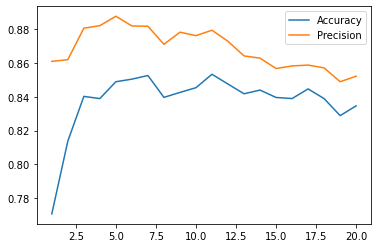

In [35]:
n_components = [r for r in range (1,21)]
  
plt.plot(n_components, AcRate, label = "Accuracy")
plt.plot(n_components, PreScore, label = "Precision")
plt.legend()
plt.show()

In [36]:
steps = [('pca', PCA(n_components=11)), ('m', ens.RandomForestClassifier(n_estimators = 300))]
model_rf = Pipeline(steps = steps)

test_acc_scores = cross_val_score(model_rf, X, y.values.ravel(), scoring='accuracy', cv=rskf, n_jobs=-1)
test_prec_scores = cross_val_score(model_rf, X, y.values.ravel(), scoring='precision', cv=rskf, n_jobs=-1)
print('n_components: 11, accuracy: ', np.mean(test_acc_scores))
print('n_components: 11, precision: ', np.mean(test_prec_scores))

n_components: 11, accuracy:  0.854054887449892
n_components: 11, precision:  0.8727190677173513


### Ridge Classifier

In [37]:
#RIDGE
rskf = RepeatedStratifiedKFold(n_splits=3, n_repeats=10)
steps = [('pca', PCA(n_components=10)), ('m', lm.RidgeClassifier(alpha = 0.7))]
model_rid = Pipeline(steps = steps)

test_acc_scores = cross_val_score(model_rid, X_norm, y.values.ravel(), scoring='accuracy', cv=rskf, n_jobs=-1)
test_prec_scores = cross_val_score(model_rid, X_norm, y.values.ravel(), scoring='precision', cv=rskf, n_jobs=-1)
print(' ridge accuracy: ', np.mean(test_acc_scores))
print(' ridge precision: ', np.mean(test_prec_scores))

 ridge accuracy:  0.8360160345359235
 ridge precision:  0.8284810184759629


### SVC

In [41]:
steps = [('pca', PCA(n_components=10)), ('svc', SVC(C=10, kernel='sigmoid', probability = True, gamma = 'scale'))]
model_svc = Pipeline(steps = steps)

acc_scores = cross_val_score(model_svc, X_norm, y.values.ravel(), scoring='accuracy', cv=rskf, n_jobs=-1)
prec_scores = cross_val_score(model_svc, X_norm, y.values.ravel(), scoring='precision', cv=rskf, n_jobs=-1)
print('accuracy: ', np.mean(acc_scores))
print('precision: ', np.mean(prec_scores))

accuracy:  0.7742213999383287
precision:  0.817571052582663


### AdaBoost

In [42]:
AcRate = []
PreScore = []
rskf = RepeatedStratifiedKFold(n_splits=3, n_repeats=10, random_state=0)
for i in range (1,21):
    steps = [('pca', PCA(n_components=i)), ('ada', AdaBoostClassifier(n_estimators=200, learning_rate = 1, algorithm = "SAMME.R", random_state=123))]
    model_ada = Pipeline(steps = steps)

    acc_scores = cross_val_score(model_ada, X, y.values.ravel(), scoring='accuracy', cv=rskf, n_jobs=-1)
    prec_scores = cross_val_score(model_ada, X, y.values.ravel(), scoring='precision', cv=rskf, n_jobs=-1)
    AcRate.append(np.mean(acc_scores))
    PreScore.append(np.mean(prec_scores))
    print('n_components:', i, 'accuracy: ', np.mean(acc_scores))
    print('n_components:', i, 'precision: ', np.mean(prec_scores))

n_components: 1 accuracy:  0.7706136293555349
n_components: 1 precision:  0.8609885784141814
n_components: 2 accuracy:  0.8087727412889301
n_components: 2 precision:  0.8713572163792421
n_components: 3 accuracy:  0.8188097440641382
n_components: 3 precision:  0.8768865160896185
n_components: 4 accuracy:  0.8339192106074622
n_components: 4 precision:  0.8858528710012514
n_components: 5 accuracy:  0.8397163120567375
n_components: 5 precision:  0.8917541390142011
n_components: 6 accuracy:  0.8253006475485661
n_components: 6 precision:  0.884015002936131
n_components: 7 accuracy:  0.8296484736355226
n_components: 7 precision:  0.8855850502533655
n_components: 8 accuracy:  0.8274128893000309
n_components: 8 precision:  0.8849572098813066
n_components: 9 accuracy:  0.8368177613321
n_components: 9 precision:  0.8920127384293359
n_components: 10 accuracy:  0.8454054887449892
n_components: 10 precision:  0.893392055571408
n_components: 11 accuracy:  0.8533148319457292
n_components: 11 precision

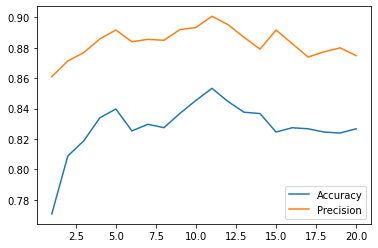

In [43]:
import matplotlib.pyplot as plt
   
n_components = [r for r in range (1,21)]
  
plt.plot(n_components, AcRate, label = "Accuracy")
plt.plot(n_components, PreScore, label = "Precision")
plt.legend()
plt.show()

In [44]:
steps = [('pca', PCA(n_components=11)), ('ada', AdaBoostClassifier(n_estimators=200, learning_rate = 1, algorithm = "SAMME.R"))]
model_ada = Pipeline(steps = steps)

acc_scores = cross_val_score(model_ada, X, y.values.ravel(), scoring='accuracy', cv=rskf, n_jobs=-1)
prec_scores = cross_val_score(model_ada, X, y.values.ravel(), scoring='precision', cv=rskf, n_jobs=-1)
print('n_components: accuracy: ', np.mean(acc_scores))
print('n_components: precision: ', np.mean(prec_scores))

n_components: accuracy:  0.8519272278754239
n_components: precision:  0.8982019146857042


### XGBoost

In [ ]:
AcRate = []
PreScore = []
rskf = RepeatedStratifiedKFold(n_splits=3, n_repeats=10, random_state=0)
for i in range (1,21):
    steps = [('pca', PCA(n_components=i)), ('xg', XGBClassifier())]
    model_xg = Pipeline(steps = steps)

    acc_scores = cross_val_score(model_xg, X, y.values.ravel(), scoring='accuracy', cv=rskf, n_jobs=-1)
    prec_scores = cross_val_score(model_xg, X, y.values.ravel(), scoring='precision', cv=rskf, n_jobs=-1)
    AcRate.append(np.mean(acc_scores))
    PreScore.append(np.mean(prec_scores))
    print('n_components:', i, 'accuracy: ', np.mean(acc_scores))
    print('n_components:', i, 'precision: ', np.mean(prec_scores))

In [ ]:
n_components = [r for r in range (1,21)]
  
plt.plot(n_components, AcRate, label = "Accuracy")
plt.plot(n_components, PreScore, label = "Precision")
plt.legend()
plt.show()

In [ ]:
#XGBoost
rskf = RepeatedStratifiedKFold(n_splits=3, n_repeats=10)
steps = [('pca', PCA(n_components=11)), ('xg', XGBClassifier())]
model_xg = Pipeline(steps = steps)

test_acc_scores = cross_val_score(model_xg, X, y.values.ravel(), scoring='accuracy', cv=rskf, n_jobs=-1)
test_prec_scores = cross_val_score(model_xg, X, y.values.ravel(), scoring='precision', cv=rskf, n_jobs=-1)
print(' XGBoost accuracy: ', np.mean(test_acc_scores))
print(' XGBoost precision: ', np.mean(test_prec_scores))

### CATBoost

In [ ]:
#CATBoost
rskf = RepeatedStratifiedKFold(n_splits=3, n_repeats=10)
steps = [('pca', PCA(n_components=10)), ('cat', CatBoostClassifier(iterations = 100, verbose=10))]
model_cat = Pipeline(steps = steps)

test_acc_scores = cross_val_score(model_cat, X, y.values.ravel(), scoring='accuracy', cv=rskf, n_jobs=-1)
test_prec_scores = cross_val_score(model_cat, X, y.values.ravel(), scoring='precision', cv=rskf, n_jobs=-1)
print(' ridge accuracy: ', np.mean(test_acc_scores))
print(' ridge precision: ', np.mean(test_prec_scores))

In [ ]:
AcRate = []
PreScore = []
rskf = RepeatedStratifiedKFold(n_splits=3, n_repeats=10, random_state=0)
for i in range (1,21):
    steps = [('pca', PCA(n_components=i)), ('cat', CatBoostClassifier(iterations = 100, verbose=10))]
    model_cat = Pipeline(steps = steps)

    acc_scores = cross_val_score(model_cat, X, y.values.ravel(), scoring='accuracy', cv=rskf, n_jobs=-1)
    prec_scores = cross_val_score(model_cat, X, y.values.ravel(), scoring='precision', cv=rskf, n_jobs=-1)
    AcRate.append(np.mean(acc_scores))
    PreScore.append(np.mean(prec_scores))
    print('n_components:', i, 'accuracy: ', np.mean(acc_scores))
    print('n_components:', i, 'precision: ', np.mean(prec_scores))

In [ ]:
n_components = [r for r in range (1,21)]
  
plt.plot(n_components, AcRate, label = "Accuracy")
plt.plot(n_components, PreScore, label = "Precision")
plt.legend()
plt.show()

In [ ]:
#CATBoost
rskf = RepeatedStratifiedKFold(n_splits=3, n_repeats=10)
steps = [('pca', PCA(n_components=10)), ('cat', CatBoostClassifier(iterations = 100, verbose=10))]
model_cat = Pipeline(steps = steps)

test_acc_scores = cross_val_score(model_cat, X, y.values.ravel(), scoring='accuracy', cv=rskf, n_jobs=-1)
test_prec_scores = cross_val_score(model_cat, X, y.values.ravel(), scoring='precision', cv=rskf, n_jobs=-1)
print(' ridge accuracy: ', np.mean(test_acc_scores))
print(' ridge precision: ', np.mean(test_prec_scores))

# PCA then Hyperparameters Tuning - Updated Data

### Ada Boost

In [48]:
from sklearn.model_selection import GridSearchCV

#Ada Boost
# 10X ITERATED STRATIFIED 3-FOLD CROSS-VALIDATED ACCURACY AND PRECISION
rskf = RepeatedStratifiedKFold(n_splits=3, n_repeats=10, random_state=0)
steps = [('pca', PCA()), ('ada', AdaBoostClassifier(random_state=123))]
model_ada = Pipeline(steps = steps)

# Creating space for different hyperparameters
space = dict()
space['pca__n_components'] = [i for i in range(2, 21)]
space['ada__n_estimators'] = [10, 50, 100, 150, 200, 250, 300]
space['ada__learning_rate'] = [10**i for i in range(-7,1)]
space['ada__algorithm'] = ['SAMME', 'SAMME.R']

# Search
search = GridSearchCV(model_ada, space, scoring='accuracy', cv=rskf, n_jobs=-1, verbose = 2)
result = search.fit(X, y.values.ravel())

#Print Result
print('Best Score: %s' % result.best_score_)
print('Best Hyperparameters: %s' % result.best_params_)

Fitting 30 folds for each of 2128 candidates, totalling 63840 fits
[CV] END ada__algorithm=SAMME, ada__learning_rate=1e-07, ada__n_estimators=10, pca__n_components=2; total time=   0.7s
[CV] END ada__algorithm=SAMME, ada__learning_rate=1e-07, ada__n_estimators=10, pca__n_components=2; total time=   0.4s
[CV] END ada__algorithm=SAMME, ada__learning_rate=1e-07, ada__n_estimators=10, pca__n_components=2; total time=   0.3s
[CV] END ada__algorithm=SAMME, ada__learning_rate=1e-07, ada__n_estimators=10, pca__n_components=3; total time=   0.4s
[CV] END ada__algorithm=SAMME, ada__learning_rate=1e-07, ada__n_estimators=10, pca__n_components=3; total time=   0.3s
[CV] END ada__algorithm=SAMME, ada__learning_rate=1e-07, ada__n_estimators=10, pca__n_components=3; total time=   0.3s
[CV] END ada__algorithm=SAMME, ada__learning_rate=1e-07, ada__n_estimators=10, pca__n_components=4; total time=   0.3s
[CV] END ada__algorithm=SAMME, ada__learning_rate=1e-07, ada__n_estimators=10, pca__n_components=4; 

In [211]:
#ada_result = pd.DataFrame(result.cv_results_)
#ada_result.head()

In [52]:
#Fit Again to confirm the Model Performance
steps = [('pca', PCA(n_components=10)), ('ada', AdaBoostClassifier(n_estimators=250, learning_rate = 1, algorithm = "SAMME"))]
model_ada = Pipeline(steps = steps)

acc_scores = cross_val_score(model_ada, X, y.values.ravel(), scoring='accuracy', cv=rskf, n_jobs=-1)
prec_scores = cross_val_score(model_ada, X, y.values.ravel(), scoring='precision', cv=rskf, n_jobs=-1)
print('n_components: accuracy: ', np.mean(acc_scores))
print('n_components: precision: ', np.mean(prec_scores))

n_components: accuracy:  0.8561825470243601
n_components: precision:  0.9030131074198233


### Random Forest

In [53]:
#Random Forest
# 10X ITERATED STRATIFIED 3-FOLD CROSS-VALIDATED ACCURACY AND PRECISION
rskf = RepeatedStratifiedKFold(n_splits=3, n_repeats=10, random_state=0)
steps = [('pca', PCA(n_components=i)), ('rf', ens.RandomForestClassifier(random_state=123))]
model_rf = Pipeline(steps = steps)

# Creating space for different hyperparameters
space = dict()
space['pca__n_components'] = [i for i in range(2, 21)]
space['rf__n_estimators'] = [50, 100, 150, 200, 300, 400, 500]
space['rf__max_depth'] = [None, 5, 10, 14, 19, 25, 30]
space['rf__criterion'] = ['gini', 'entropy']

# Search
search = GridSearchCV(model_rf, space, scoring='accuracy', cv=rskf, n_jobs=-1, verbose = 2)
result = search.fit(X, y.values.ravel())

#Print Result
print('Best Score: %s' % result.best_score_)
print('Best Hyperparameters: %s' % result.best_params_)

Fitting 30 folds for each of 1862 candidates, totalling 55860 fits
[CV] END ada__algorithm=SAMME.R, ada__learning_rate=1, ada__n_estimators=150, pca__n_components=10; total time=   0.4s
[CV] END ada__algorithm=SAMME.R, ada__learning_rate=1, ada__n_estimators=150, pca__n_components=10; total time=   0.4s
[CV] END ada__algorithm=SAMME.R, ada__learning_rate=1, ada__n_estimators=150, pca__n_components=10; total time=   0.4s
[CV] END ada__algorithm=SAMME.R, ada__learning_rate=1, ada__n_estimators=150, pca__n_components=11; total time=   0.5s
[CV] END ada__algorithm=SAMME.R, ada__learning_rate=1, ada__n_estimators=150, pca__n_components=11; total time=   0.4s
[CV] END ada__algorithm=SAMME.R, ada__learning_rate=1, ada__n_estimators=150, pca__n_components=11; total time=   0.4s
[CV] END ada__algorithm=SAMME.R, ada__learning_rate=1, ada__n_estimators=150, pca__n_components=12; total time=   0.5s
[CV] END ada__algorithm=SAMME.R, ada__learning_rate=1, ada__n_estimators=150, pca__n_components=12; 

In [54]:
print('Best Score: %s' % result.best_score_)
print('Best Hyperparameters: %s' % result.best_params_)

Best Score: 0.8597903176071537
Best Hyperparameters: {'pca__n_components': 12, 'rf__criterion': 'entropy', 'rf__max_depth': 19, 'rf__n_estimators': 50}


In [212]:
#rf_result = pd.DataFrame(result.cv_results_)
#rf_result.head()

Learning rate set to 0.030866
0:	learn: 0.6758728	total: 374ms	remaining: 37s
1:	learn: 0.6651282	total: 511ms	remaining: 25s
2:	learn: 0.6527109	total: 650ms	remaining: 21s
3:	learn: 0.6370796	total: 746ms	remaining: 17.9s
4:	learn: 0.6243708	total: 909ms	remaining: 17.3s
5:	learn: 0.6118141	total: 1.04s	remaining: 16.3s
6:	learn: 0.5992749	total: 1.2s	remaining: 15.9s
7:	learn: 0.5852407	total: 1.33s	remaining: 15.3s
8:	learn: 0.5758506	total: 1.46s	remaining: 14.7s
9:	learn: 0.5632411	total: 1.65s	remaining: 14.8s
10:	learn: 0.5563990	total: 1.7s	remaining: 13.7s
11:	learn: 0.5478377	total: 1.84s	remaining: 13.5s
12:	learn: 0.5395582	total: 1.92s	remaining: 12.8s
13:	learn: 0.5262918	total: 2.07s	remaining: 12.7s
14:	learn: 0.5200856	total: 2.13s	remaining: 12s
15:	learn: 0.5135777	total: 2.23s	remaining: 11.7s
16:	learn: 0.4959361	total: 2.4s	remaining: 11.7s
17:	learn: 0.4854245	total: 2.52s	remaining: 11.5s
18:	learn: 0.4756110	total: 2.63s	remaining: 11.2s
19:	learn: 0.4687552	t

In [57]:
steps = [('pca', PCA(n_components=12)), ('m', ens.RandomForestClassifier(n_estimators = 50, max_depth = 19, criterion = "entropy"))]
model_rf = Pipeline(steps = steps)

test_acc_scores = cross_val_score(model_rf, X, y.values.ravel(), scoring='accuracy', cv=rskf, n_jobs=-1)
test_prec_scores = cross_val_score(model_rf, X, y.values.ravel(), scoring='precision', cv=rskf, n_jobs=-1)
print('n_components: 11, accuracy: ', np.mean(test_acc_scores))
print('n_components: 11, precision: ', np.mean(test_prec_scores))

n_components: 11, accuracy:  0.853345667591736
n_components: 11, precision:  0.8730343981081361


### Ridge Classifier

# Hyperparameters Tuning - Updated Data

### AdaBoost

In [213]:
from sklearn.model_selection import GridSearchCV

#Ada Boost
# 10X ITERATED STRATIFIED 3-FOLD CROSS-VALIDATED ACCURACY AND PRECISION
rskf = RepeatedStratifiedKFold(n_splits=3, n_repeats=10, random_state=0)
steps = [('pca', PCA()), ('ada', AdaBoostClassifier(random_state=123))]
model_ada = Pipeline(steps = steps)

# Creating space for different hyperparameters
space = dict()
space['pca__n_components'] = [i for i in range(2, 21)]
space['ada__n_estimators'] = [10, 50, 100, 150, 200, 250, 300]
space['ada__learning_rate'] = [10**i for i in range(-7,1)]
space['ada__algorithm'] = ['SAMME', 'SAMME.R']

# Search
ada_search = GridSearchCV(model_ada, space, scoring='accuracy', cv=rskf, n_jobs=-1, verbose = 2)
ada_result = ada_search.fit(X_new, y_new.values.ravel())

#Print Result
print('Best Score: %s' % ada_result.best_score_)
print('Best Hyperparameters: %s' % ada_result.best_params_)

Fitting 30 folds for each of 2128 candidates, totalling 63840 fits
[CV] END ada__algorithm=SAMME, ada__learning_rate=1e-07, ada__n_estimators=10, pca__n_components=2; total time=   0.6s
[CV] END ada__algorithm=SAMME, ada__learning_rate=1e-07, ada__n_estimators=10, pca__n_components=2; total time=   0.5s
[CV] END ada__algorithm=SAMME, ada__learning_rate=1e-07, ada__n_estimators=10, pca__n_components=2; total time=   0.3s
[CV] END ada__algorithm=SAMME, ada__learning_rate=1e-07, ada__n_estimators=10, pca__n_components=3; total time=   0.4s
[CV] END ada__algorithm=SAMME, ada__learning_rate=1e-07, ada__n_estimators=10, pca__n_components=3; total time=   0.3s
[CV] END ada__algorithm=SAMME, ada__learning_rate=1e-07, ada__n_estimators=10, pca__n_components=3; total time=   0.4s
[CV] END ada__algorithm=SAMME, ada__learning_rate=1e-07, ada__n_estimators=10, pca__n_components=4; total time=   0.4s
[CV] END ada__algorithm=SAMME, ada__learning_rate=1e-07, ada__n_estimators=10, pca__n_components=4; 

In [232]:
#Print Result
print('Best Score: %s' % ada_result.best_score_)
print('Best Hyperparameters: %s' % ada_result.best_params_)

Best Score: 0.8740980573543017
Best Hyperparameters: {'ada__algorithm': 'SAMME.R', 'ada__learning_rate': 0.1, 'ada__n_estimators': 300, 'pca__n_components': 15}


In [233]:
ada_result_tb = pd.DataFrame(ada_result.cv_results_)
ada_result_tb.head()

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_ada__algorithm,param_ada__learning_rate,param_ada__n_estimators,param_pca__n_components,params,split0_test_score,...,split23_test_score,split24_test_score,split25_test_score,split26_test_score,split27_test_score,split28_test_score,split29_test_score,mean_test_score,std_test_score,rank_test_score
0,0.340336,0.101253,0.135251,0.029772,SAMME,0.0,10,2,"{'ada__algorithm': 'SAMME', 'ada__learning_rat...",0.787234,...,0.804348,0.787234,0.804348,0.804348,0.787234,0.804348,0.804348,0.798643,0.008068,581
1,0.264435,0.032849,0.117273,0.016656,SAMME,0.0,10,3,"{'ada__algorithm': 'SAMME', 'ada__learning_rat...",0.787234,...,0.804348,0.787234,0.804348,0.804348,0.787234,0.804348,0.804348,0.798643,0.008068,581
2,0.276307,0.026247,0.120974,0.025782,SAMME,0.0,10,4,"{'ada__algorithm': 'SAMME', 'ada__learning_rat...",0.787234,...,0.804348,0.787234,0.804348,0.804348,0.787234,0.804348,0.804348,0.798643,0.008068,581
3,0.296067,0.045137,0.117563,0.021104,SAMME,0.0,10,5,"{'ada__algorithm': 'SAMME', 'ada__learning_rat...",0.787234,...,0.804348,0.787234,0.804348,0.804348,0.787234,0.804348,0.804348,0.798643,0.008068,581
4,0.352693,0.056664,0.121887,0.017752,SAMME,0.0,10,6,"{'ada__algorithm': 'SAMME', 'ada__learning_rat...",0.787234,...,0.804348,0.787234,0.804348,0.804348,0.787234,0.804348,0.804348,0.798643,0.008068,581


In [236]:
#Fit Again Using the best hyperparameters to confirm the Model Performance
steps = [('pca', PCA(n_components=15)), ('ada', AdaBoostClassifier(n_estimators=300, learning_rate = 0.1, algorithm = "SAMME.R"))]
model_ada = Pipeline(steps = steps)

rskf = RepeatedStratifiedKFold(n_splits=5, n_repeats=20)
acc_scores = cross_val_score(model_ada, X_new, y_new.values.ravel(), scoring='accuracy', cv=rskf, n_jobs=-1)
prec_scores = cross_val_score(model_ada, X_new, y_new.values.ravel(), scoring='precision', cv=rskf, n_jobs=-1)
print('n_components: accuracy: ', np.mean(acc_scores))
print('n_components: precision: ', np.mean(prec_scores))

n_components: accuracy:  0.8650396825396824
n_components: precision:  0.9171565839766643


In [245]:
#Fit Again Using the best hyperparameters to confirm the Model Performance
rskf = RepeatedStratifiedKFold(n_splits=5, n_repeats=100)
steps = [('pca', PCA(n_components=15)), ('ada', AdaBoostClassifier(n_estimators=300, learning_rate = 0.1, algorithm = "SAMME.R"))]
model_ada = Pipeline(steps = steps)

rskf = RepeatedStratifiedKFold(n_splits=5, n_repeats=20)
acc_scores = cross_val_score(model_ada, X_new, y_new.values.ravel(), scoring='accuracy', cv=rskf, n_jobs=-1)
prec_scores = cross_val_score(model_ada, X_new, y_new.values.ravel(), scoring='precision', cv=rskf, n_jobs=-1)
print('n_components 15: accuracy: ', np.mean(acc_scores))
print('n_components 15: precision: ', np.mean(prec_scores))
print('n_components: 15, accuracy_std: ', np.std(test_acc_scores))
print('n_components: 15, precision_std: ', np.std(test_prec_scores))


n_components 15: accuracy:  0.8677380952380953
n_components 15: precision:  0.9137335876853041
n_components: 15, accuracy_std:  0.055378601025875544
n_components: 15, precision_std:  0.046408404541565064


### Random Forest

In [237]:
#Random Forest
# 10X ITERATED STRATIFIED 3-FOLD CROSS-VALIDATED ACCURACY AND PRECISION
rskf = RepeatedStratifiedKFold(n_splits=3, n_repeats=10, random_state=0)
steps = [('pca', PCA(n_components=i)), ('rf', ens.RandomForestClassifier(random_state=123))]
model_rf = Pipeline(steps = steps)

# Creating space for different hyperparameters
space = dict()
space['pca__n_components'] = [i for i in range(2, 21)]
space['rf__n_estimators'] = [50, 100, 150, 200, 300, 400, 500]
space['rf__max_depth'] = [None, 5, 10, 14, 19, 25, 30]
space['rf__criterion'] = ['gini', 'entropy']

# Search
rf_search = GridSearchCV(model_rf, space, scoring='accuracy', cv=rskf, n_jobs=-1, verbose = 2)
rf_result = search.fit(X_new, y_new.values.ravel())

#Print Result
print('Best Score: %s' % rf_result.best_score_)
print('Best Hyperparameters: %s' % rf_result.best_params_)

Fitting 30 folds for each of 1862 candidates, totalling 55860 fits
[CV] END ada__algorithm=SAMME.R, ada__learning_rate=0.1, ada__n_estimators=250, pca__n_components=5; total time=   0.7s
[CV] END ada__algorithm=SAMME.R, ada__learning_rate=0.1, ada__n_estimators=250, pca__n_components=5; total time=   0.7s
[CV] END ada__algorithm=SAMME.R, ada__learning_rate=0.1, ada__n_estimators=250, pca__n_components=6; total time=   0.7s
[CV] END ada__algorithm=SAMME.R, ada__learning_rate=0.1, ada__n_estimators=250, pca__n_components=6; total time=   0.7s
[CV] END ada__algorithm=SAMME.R, ada__learning_rate=0.1, ada__n_estimators=250, pca__n_components=6; total time=   0.7s
[CV] END ada__algorithm=SAMME.R, ada__learning_rate=0.1, ada__n_estimators=250, pca__n_components=7; total time=   0.7s
[CV] END ada__algorithm=SAMME.R, ada__learning_rate=0.1, ada__n_estimators=250, pca__n_components=7; total time=   0.7s
[CV] END ada__algorithm=SAMME.R, ada__learning_rate=0.1, ada__n_estimators=250, pca__n_compon

In [238]:
print('Best Score: %s' % rf_result.best_score_)
print('Best Hyperparameters: %s' % rf_result.best_params_)

Best Score: 0.8914739438791243
Best Hyperparameters: {'pca__n_components': 14, 'rf__criterion': 'entropy', 'rf__max_depth': 14, 'rf__n_estimators': 50}


In [239]:
rf_result_tb = pd.DataFrame(result.cv_results_)
rf_result_tb.head()

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_pca__n_components,param_rf__criterion,param_rf__max_depth,param_rf__n_estimators,params,split0_test_score,...,split23_test_score,split24_test_score,split25_test_score,split26_test_score,split27_test_score,split28_test_score,split29_test_score,mean_test_score,std_test_score,rank_test_score
0,0.496140,0.198866,0.137608,0.015674,2,gini,None,50,"{'pca__n_components': 2, 'rf__criterion': 'gin...",0.765957,...,0.760870,0.680851,0.804348,0.869565,0.787234,0.804348,0.847826,0.780620,0.059292,1853
1,0.372091,0.020408,0.137956,0.012093,2,gini,None,100,"{'pca__n_components': 2, 'rf__criterion': 'gin...",0.787234,...,0.760870,0.680851,0.804348,0.869565,0.765957,0.804348,0.869565,0.782084,0.055723,1842
2,0.579794,0.174800,0.148309,0.031597,2,gini,None,150,"{'pca__n_components': 2, 'rf__criterion': 'gin...",0.787234,...,0.782609,0.659574,0.804348,0.869565,0.765957,0.804348,0.847826,0.786432,0.054098,1826
3,0.470952,0.034760,0.135006,0.010626,2,gini,None,200,"{'pca__n_components': 2, 'rf__criterion': 'gin...",0.765957,...,0.782609,0.659574,0.804348,0.869565,0.765957,0.804348,0.826087,0.782840,0.053057,1834
4,0.563047,0.035145,0.153276,0.026753,2,gini,None,300,"{'pca__n_components': 2, 'rf__criterion': 'gin...",0.787234,...,0.760870,0.680851,0.804348,0.869565,0.765957,0.804348,0.847826,0.787126,0.053777,1816


In [241]:
#Fit Again using the best hyperparameters to confirm the Model Performance
steps = [('pca', PCA(n_components=14)), ('m', ens.RandomForestClassifier(n_estimators = 50, max_depth = 14, criterion = "entropy"))]
model_rf = Pipeline(steps = steps)

test_acc_scores = cross_val_score(model_rf, X_new, y_new.values.ravel(), scoring='accuracy', cv=rskf, n_jobs=-1)
test_prec_scores = cross_val_score(model_rf, X_new, y_new.values.ravel(), scoring='precision', cv=rskf, n_jobs=-1)
print('n_components: 14, accuracy: ', np.mean(test_acc_scores))
print('n_components: 14, precision: ', np.mean(test_prec_scores))

n_components: 14, accuracy:  0.8799568300955907
n_components: 14, precision:  0.9134932566661527


In [244]:
#Fit Again using the best hyperparameters to confirm the Model Performance
rskf = RepeatedStratifiedKFold(n_splits=5, n_repeats=100, random_state=0)

steps = [('pca', PCA(n_components=14)), ('m', ens.RandomForestClassifier(n_estimators = 50, max_depth = 14, criterion = "entropy"))]
model_rf = Pipeline(steps = steps)

test_acc_scores = cross_val_score(model_rf, X_new, y_new.values.ravel(), scoring='accuracy', cv=rskf, n_jobs=-1)
test_prec_scores = cross_val_score(model_rf, X_new, y_new.values.ravel(), scoring='precision', cv=rskf, n_jobs=-1)
print('n_components: 14, accuracy: ', np.mean(test_acc_scores))
print('n_components: 14, precision: ', np.mean(test_prec_scores))
print('n_components: 14, accuracy_std: ', np.std(test_acc_scores))
print('n_components: 14, precision_std: ', np.std(test_prec_scores))

n_components: 14, accuracy:  0.8751746031746033
n_components: 14, precision:  0.9035746850924561
n_components: 14, accuracy_std:  0.055378601025875544
n_components: 14, precision_std:  0.046408404541565064


In [249]:
print('n_components: 14, accuracy_std: ', np.percentile(test_acc_scores, 20))
print('n_components: 14, precision_std: ', np.percentile(test_prec_scores, 20))

n_components: 14, accuracy_std:  0.8214285714285714
n_components: 14, precision_std:  0.8695652173913043


# Feature Importance

In [ ]:
# Dropping Gene
df_sect_only = df_all.copy()
df_sect_only = df_sect_only.drop(columns = [x for x in df_sect_only.columns if 'gene_'  in x])

In [ ]:
# SIMILARLY, WANT MORE ROBUST IDEA OF RF FI; GOING TO ITERATRE THRU 10K TIMES
X_sect = df_sect_only.drop(columns = [x for x in df_sect_only.columns if x == 'outcome' or x == 'sample_id'])

y_sect = df_sect_only.drop(columns = [x for x in df_sect_only.columns if x != 'outcome'])
final_df = pd.DataFrame()

for i in range(1000):
    X_train, X_test, y_train, y_test = train_test_split(X_sect, y_sect, 
                                                        stratify = y_sect, 
                                                        test_size = 0.2)

    model_ada = AdaBoostClassifier(n_estimators=200, learning_rate = 1, algorithm = "SAMME.R").fit(X_train, y_train.values.ravel())
    
    feature_names = [x for x in df_sect_only.columns if x != 'outcome' and x != 'sample_id']
    importances = model_ada.feature_importances_
    data = {'feature_names': feature_names, 'feature_importance': importances}
    fi_df = pd.DataFrame(data)
    
    final_df = pd.concat([final_df, fi_df])
    

In [ ]:
keep_df = final_df.copy()

keep_df = keep_df.groupby('feature_names').sum().reset_index()

# CONVERT TO AVERAGE
keep_df['feature_importance'] = keep_df['feature_importance'].apply(lambda x: x/10000)

keep_df.sort_values(by = ['feature_importance'], ascending = False, inplace = True)

#keep_df.to_csv("ada_fi_tmp.csv")

In [ ]:
keep_df = pd.read_csv("ada_fi_tmp.csv")
plt.figure(figsize = (5, 7))
plt.scatter(keep_df.head(25)['feature_importance'], keep_df.head(25)['feature_names'])
# plt.tick_params(color='white', labelcolor='white')
plt.title("RF Feature Importance Avg. - 10,000 Iterations")#, color = 'white')
plt.savefig("fi_10k", bbox_inches='tight')